<a href="https://colab.research.google.com/github/DejanGjer/SRGAN/blob/main/SRResNet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!nvidia-smi

Mon May 17 18:28:11 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.19.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   38C    P0    28W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
zip_path = "/content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/CelebaHQ_org.zip"
!cp "{zip_path}" .
!unzip -q "CelebaHQ_org.zip"
!rm "CelebaHQ_org.zip"

In [ ]:
import os,shutil
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials
import datetime
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import keras
import matplotlib.pyplot as plt
import numpy as np

import cv2
from tqdm import tqdm

from tensorflow.keras.models import Model
from tensorflow.keras.layers import BatchNormalization, LeakyReLU, Conv2D, Dense, \
                         Flatten, Add, PReLU, Conv2DTranspose, Lambda, UpSampling2D                    
from keras.optimizers import Adam
from keras.applications import VGG19
from keras.callbacks import ReduceLROnPlateau


# Load the TensorBoard notebook extension
%load_ext tensorboard

print("Setup complete!")

Setup complete!


In [ ]:

class LoadDataset:
    def __init__(self, relative_path, validation_split = None, image_size_large = 256, image_size_small = 64, batch_size = 16, shuffle = True, interpolation = "bilinear"):
        print(relative_path)
        self.path = os.path.join("CelebaHQ", relative_path)
        self.image_size_large = image_size_large
        self.image_size_small = image_size_small
        self.batch_size = batch_size
        self.validation_split = validation_split
        self.interpolation = interpolation
        self.shuffle = shuffle
        self.seed = 1337

        self.hr_images_train = None
        self.hr_images_valid = None
        self.lr_images_train = None
        self.lr_images_valid = None

        self.hr_images_train = self.generate(self.image_size_large, "training" if self.validation_split != None else None)
        self.lr_images_train = self.generate(self.image_size_small, "training" if self.validation_split != None else None)
        self.hr_images_train = self.hr_images_train.prefetch(buffer_size=self.batch_size)
        self.lr_images_train = self.lr_images_train.prefetch(buffer_size=self.batch_size)

        if self.validation_split != None:
            self.hr_images_valid = self.generate(self.image_size_large, "validation" if self.validation_split != None else None)
            self.lr_images_valid = self.generate(self.image_size_small, "validation" if self.validation_split != None else None)
            self.hr_images_valid = self.hr_images_valid.prefetch(buffer_size=self.batch_size)
            self.lr_images_valid = self.lr_images_valid.prefetch(buffer_size=self.batch_size)

        
    def generate(self, image_size, subset):
        return tf.keras.preprocessing.image_dataset_from_directory(
            self.path,
            labels="inferred",
            label_mode=None,
            class_names=None,
            color_mode="rgb",
            batch_size=self.batch_size,
            image_size=(image_size, image_size),
            shuffle=self.shuffle,
            seed=self.seed,
            validation_split=self.validation_split,
            subset=subset,
            interpolation=self.interpolation,
            follow_links=False,
        )


In [ ]:
train_set_size = 28000
valid_set_size = 1900
test_set_size = 100
batch_size = 64
train_valid_dataset = LoadDataset("train_valid_set", validation_split=valid_set_size/(train_set_size + valid_set_size), batch_size=batch_size)
test_dataset = LoadDataset("test_set",batch_size=batch_size, shuffle=False)

train_valid_set
Found 29900 files belonging to 1 classes.
Using 28000 files for training.
Found 29900 files belonging to 1 classes.
Using 28000 files for training.
Found 29900 files belonging to 1 classes.
Using 1900 files for validation.
Found 29900 files belonging to 1 classes.
Using 1900 files for validation.
test_set
Found 100 files belonging to 1 classes.
Found 100 files belonging to 1 classes.


In [ ]:

class SRResNet:
    def __init__(self):
        self.upscale_factor = 4
        self.model = self.build((64, 64, 3))

    def SubpixelConv2D(self,scale):
        return Lambda(lambda x: tf.nn.depth_to_space(x, scale))


    def res_block(self, input_layer):
        x = Conv2D(filters=64, kernel_size=3, strides=1, padding="same")(input_layer)
        x = BatchNormalization(momentum=0.8)(x)
        x = PReLU()(x)
        x = Conv2D(filters=64, kernel_size=3, strides=1, padding="same")(x)
        x = BatchNormalization(momentum=0.8)(x)
        return Add()([input_layer, x])

    def upsample_block(self, input_layer):
        x = Conv2D(filters=256, kernel_size=3, strides=1, padding="same")(input_layer)
        x = self.SubpixelConv2D(2)(x)
        return PReLU()(x)

    def build(self, input_shape, res_blocks = 8):
        inputs = keras.Input(shape=input_shape)
        x = tf.keras.layers.experimental.preprocessing.Rescaling(1.0 / 255)(inputs)

        x = Conv2D(filters=64, kernel_size=9, padding="same")(x)
        x = PReLU()(x)
        output1 = x

        for _ in range(res_blocks):
            x = self.res_block(x)

        x = Conv2D(filters=64, kernel_size=3, strides=1, padding="same")(x)
        output2 = BatchNormalization(momentum=0.8)(x)
        x = Add()([output1, output2])

        for _ in range(self.upscale_factor // 2):
            x = self.upsample_block(x)

        outputs = Conv2D(filters=3, kernel_size=9, strides=1, padding="same", activation="tanh")(x)
        
        model = Model(inputs=inputs, outputs=outputs)
        model.compile(
          optimizer=keras.optimizers.Adam(learning_rate=0.0002,beta_1=0.9,beta_2=0.999),
          loss="mse",
          loss_weights=1
        )
        
        return model


In [ ]:
def plot_losses(data1,data2,title,xlabel,ylabel,name1,name2,dir):
  plt.figure(figsize = (20,12))
  plt.plot(data1)
  plt.plot(data2)
  plt.title(title)
  plt.xlabel(xlabel)
  plt.ylabel(ylabel)
  plt.legend([name1, name2], loc='upper right')
  plt.savefig(dir + ".png")

In [ ]:
%tensorboard --logdir "/content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet"

<IPython.core.display.Javascript object>

In [ ]:
def train_generator(dataset, epochs, model=None):
  train_dataset = tf.data.Dataset.zip((dataset.lr_images_train, dataset.hr_images_train))
  valid_dataset = tf.data.Dataset.zip((dataset.lr_images_valid, dataset.hr_images_valid.map(lambda x: x / 127.5 - 1.0)))
  if model == None:
    generator = SRResNet().model
  else:
    generator = model
  
  tensorboard_images_num = 2

  current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
  save_dir = "/content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/" + current_time
  train_log_dir = save_dir + "/tensorboard_train"
  save_model_dir = save_dir + "/model_checkpoints"
  charts_dir = save_dir + "/charts"
  !mkdir "$save_dir"
  !mkdir "$save_model_dir"
  !mkdir "$charts_dir"
  train_summary_writer = tf.summary.create_file_writer(train_log_dir) 

  total_iterations = train_set_size // dataset.batch_size
  train_losses = []
  valid_losses = []
  step = 0

  for epoch in range(epochs):
    for i, (lr_batch_train, hr_batch_train) in tqdm(enumerate(train_dataset), total=total_iterations, desc=f"Epoch: {epoch}", unit="batches"):
      gen_loss = generator.train_on_batch(lr_batch_train,y=(hr_batch_train / 127.5 - 1.0))

      if step % 50 == 0:
        #plt.imsave(train_images_dir + f"/lr_{step//10}.png", lr_batch_train.numpy().astype("uint8")[0])
        #plt.imsave(train_images_dir + f"/hr_{step//10}.png", hr_batch_train.numpy().astype("uint8")[0])
        #plt.imsave(train_images_dir + f"/gen_{step//10}.png", ((1 + generator(lr_batch_train,training=False).numpy()) * 127.5).astype("uint8")[0])

        train_losses.append(gen_loss)
        valid_batch = valid_dataset.take(1)
        valid_loss = generator.evaluate(x=valid_batch, verbose=0)
        valid_losses.append(valid_loss)
          
        with train_summary_writer.as_default():
          tf.summary.scalar('train_loss',gen_loss,step=step)
          tf.summary.image('train_input_images', lr_batch_train.numpy().astype("uint8")[0:tensorboard_images_num], step=step)
          tf.summary.image('train_genarated_images',((1 + generator(lr_batch_train,training=False).numpy()) * 127.5).astype("uint8")[0:tensorboard_images_num] ,step=step)
          tf.summary.image('train_real_images',hr_batch_train.numpy().astype("uint8")[0:tensorboard_images_num],step=step)
          tf.summary.scalar('valid_loss',valid_loss,step=step)
         
      step += 1

    generator.save(save_model_dir + f"/epoch_{epoch}")
    plot_losses(train_losses, valid_losses,"Train - Valid Loss","steps","loss","train loss", "valid_loss", charts_dir + f"/train_loss_after_epoch_{epoch}")


Epoch: 0: 438batches [07:33,  1.04s/batches]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_0/assets


Epoch: 1: 438batches [06:50,  1.07batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_1/assets


Epoch: 2: 438batches [06:51,  1.06batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_2/assets


Epoch: 3: 438batches [06:51,  1.06batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_3/assets


Epoch: 4: 438batches [06:49,  1.07batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_4/assets


Epoch: 5: 438batches [06:52,  1.06batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_5/assets


Epoch: 6: 438batches [06:51,  1.06batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_6/assets


Epoch: 7: 438batches [06:52,  1.06batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_7/assets


Epoch: 8: 438batches [06:51,  1.06batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_8/assets


Epoch: 9: 438batches [06:52,  1.06batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_9/assets


Epoch: 10: 438batches [06:53,  1.06batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_10/assets


Epoch: 11: 438batches [06:53,  1.06batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_11/assets


Epoch: 12: 438batches [06:52,  1.06batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_12/assets


Epoch: 13: 438batches [06:55,  1.05batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_13/assets


Epoch: 14: 438batches [06:54,  1.06batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_14/assets


Epoch: 15: 438batches [06:54,  1.06batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_15/assets


Epoch: 16: 438batches [06:53,  1.06batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_16/assets


Epoch: 17: 438batches [06:53,  1.06batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_17/assets


Epoch: 18: 438batches [06:56,  1.05batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_18/assets


Epoch: 19: 438batches [06:55,  1.05batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_19/assets


Epoch: 20: 438batches [06:53,  1.06batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_20/assets


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
Epoch: 21: 438batches [06:53,  1.06batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_21/assets


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
Epoch: 22: 438batches [06:56,  1.05batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_22/assets


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
Epoch: 23: 438batches [06:55,  1.05batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_23/assets


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
Epoch: 24: 438batches [06:53,  1.06batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_24/assets


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
Epoch: 25: 438batches [06:53,  1.06batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_25/assets


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
Epoch: 26: 438batches [06:57,  1.05batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_26/assets


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
Epoch: 27: 438batches [06:56,  1.05batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_27/assets


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
Epoch: 28: 438batches [06:56,  1.05batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_28/assets


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
Epoch: 29: 438batches [06:55,  1.05batches/s]


INFO:tensorflow:Assets written to: /content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_29/assets


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


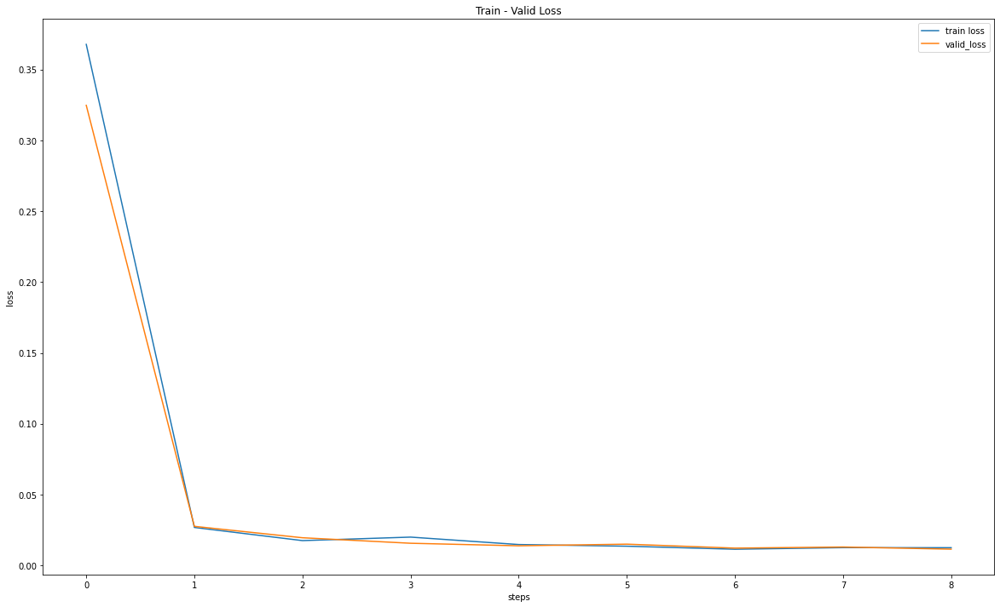

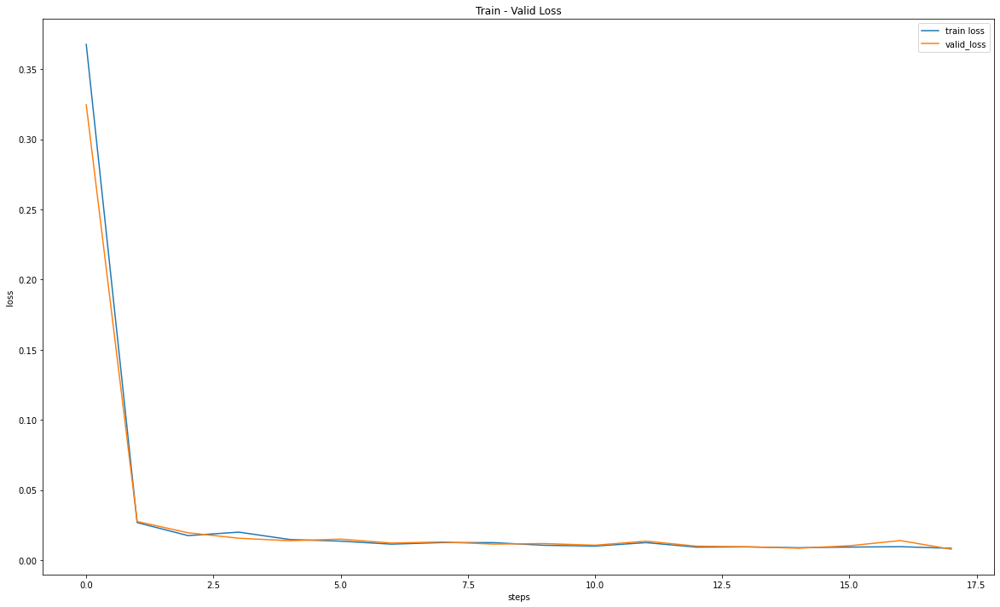

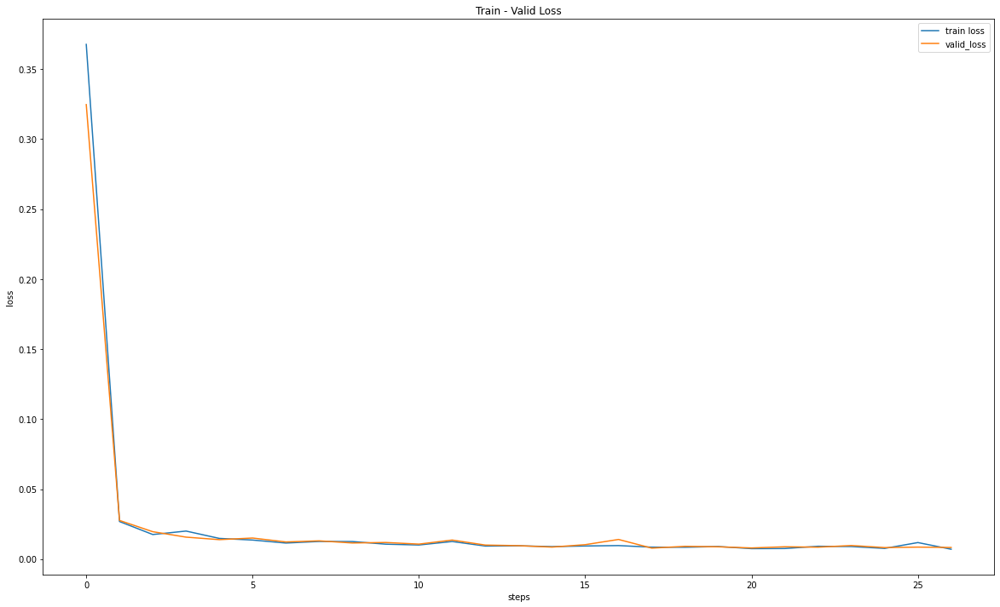

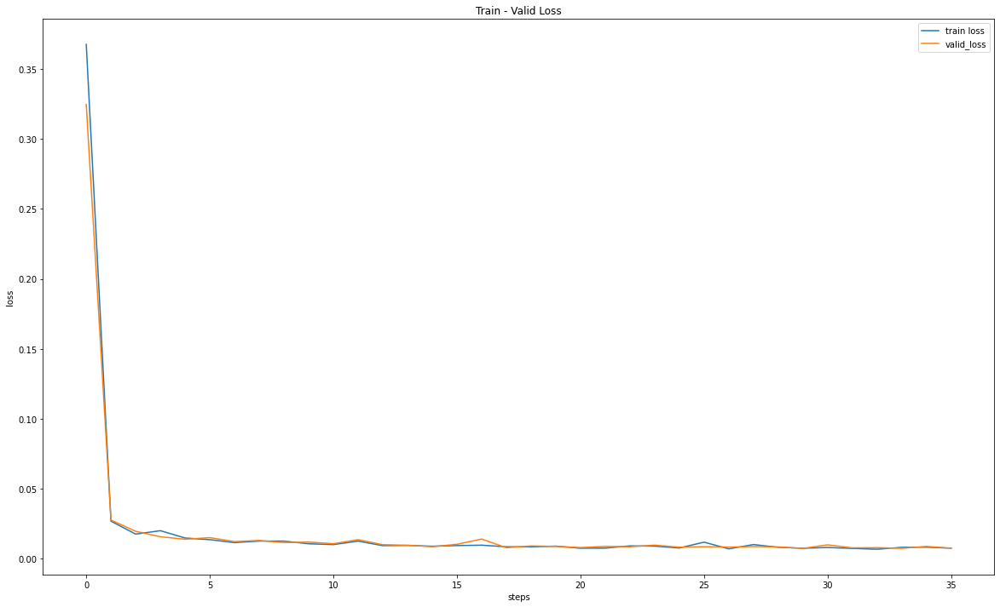

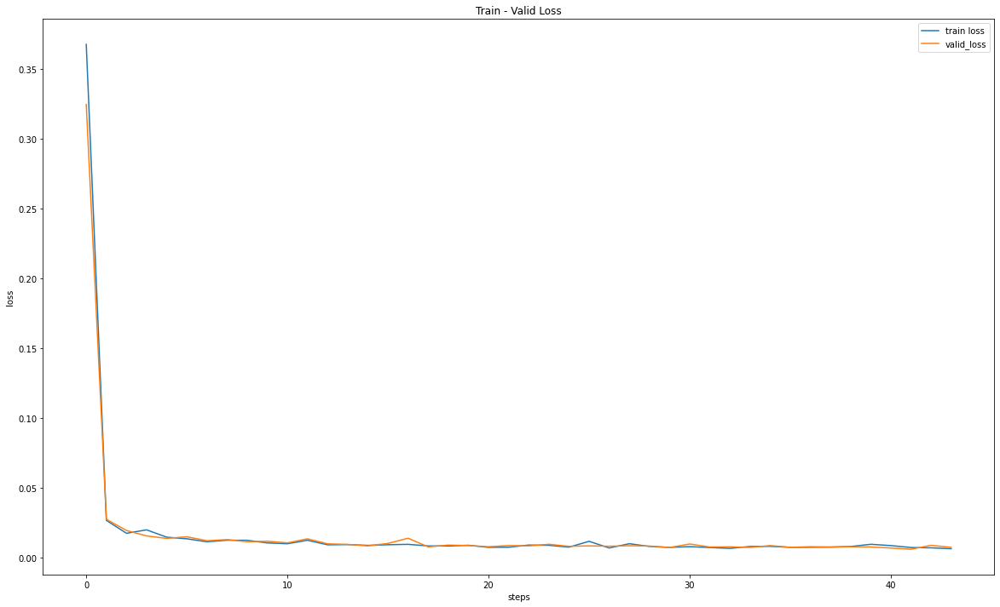

...

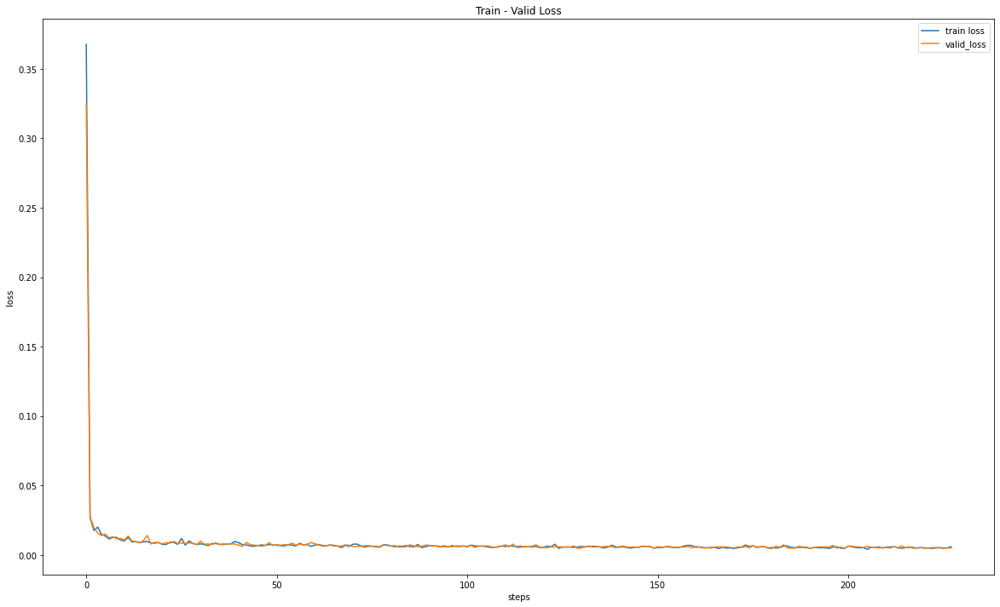

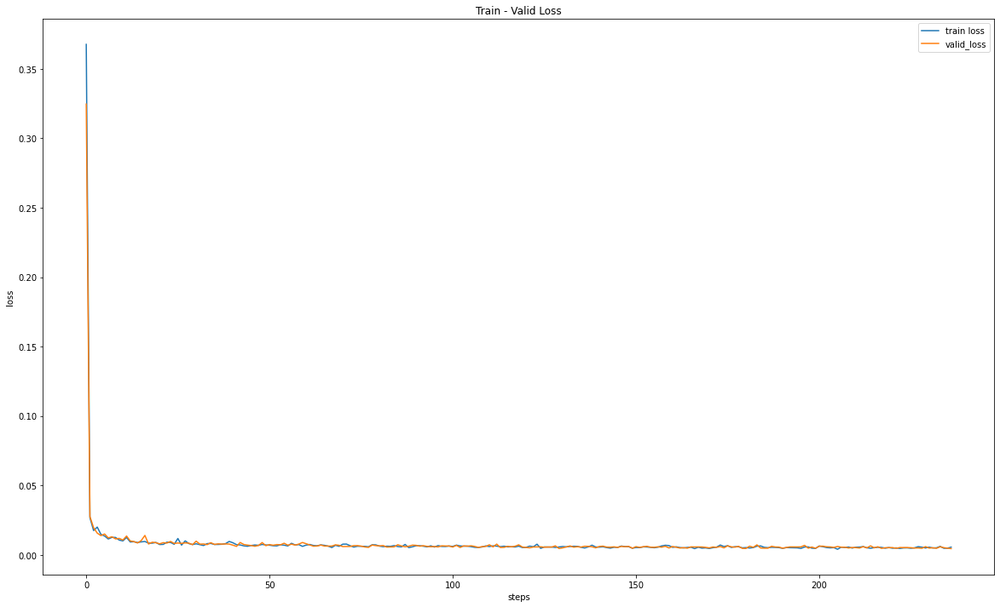

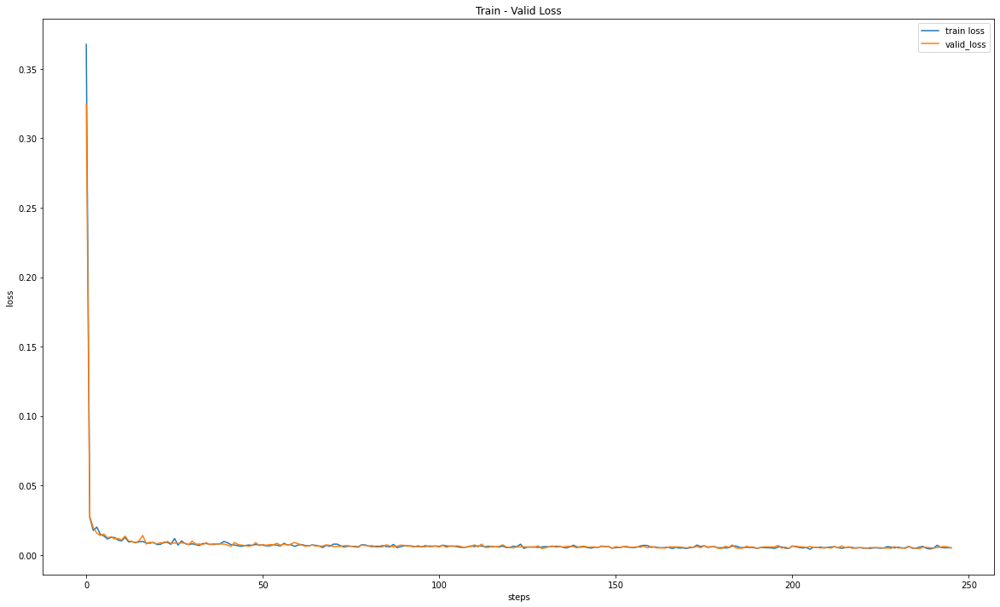

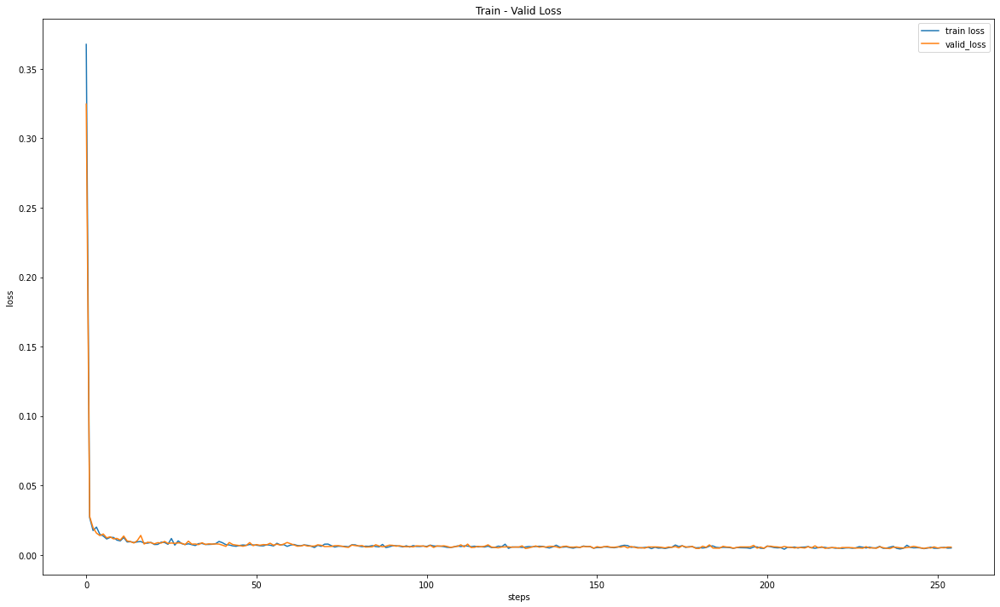

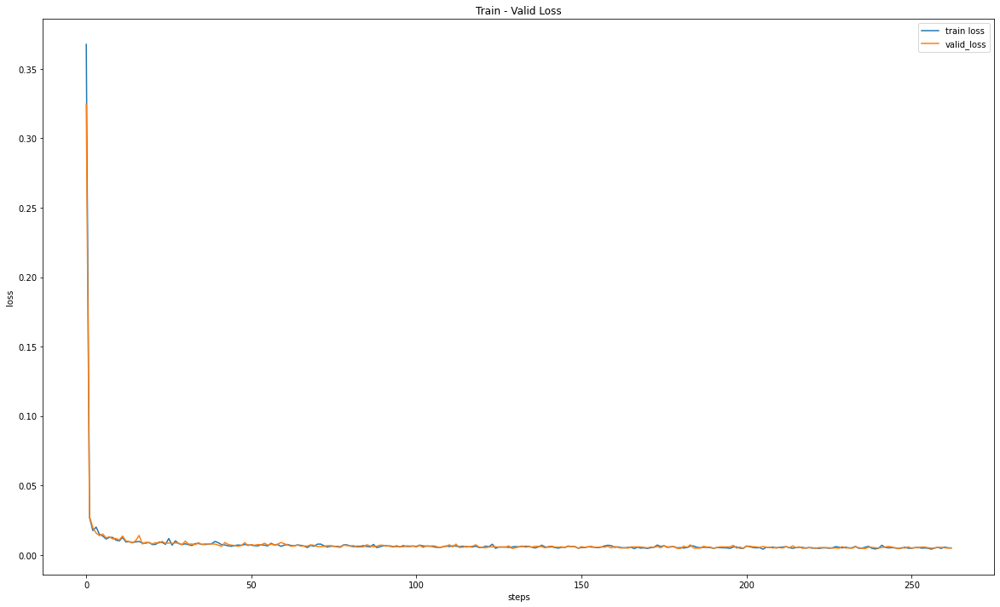

In [ ]:
train_generator(train_valid_dataset, epochs=30)

In [ ]:
model = keras.models.load_model("/content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/model_checkpoints/epoch_29")

In [ ]:
train_generator(train_valid_dataset, epochs=1, model=model)

In [ ]:
generated_images = model.predict(test_dataset.lr_images_train)
rez_dir = "/content/drive/My Drive/Colab Notebooks/SeminarskiB-NN/logs/srresnet/20210517-182937/rezultati"
print(generated_images.shape)
for i, image in enumerate(generated_images):
  plt.imsave(rez_dir + f"/{i}_gen.png", ((1 + image) * 127.5).astype('uint8'))
for i, image in enumerate(test_dataset.lr_images_train.unbatch()):
  plt.imsave(rez_dir + f"/{i}_lr.png", image.numpy().astype('uint8'))
for i, image in enumerate(test_dataset.hr_images_train.unbatch()):
  plt.imsave(rez_dir + f"/{i}_hr.png", image.numpy().astype('uint8'))

(100, 256, 256, 3)
